# TSA CLAIM ANALYSIS

## Latar Belakang
Transportation Security Administration (TSA) adalah sebuah divisi di bagian Homeland Security Department di Amerika Serikat (USA) yang berperan dalam keamanan di bandara-bandara di USA. TSA berdiri pada tahun 2001 dengan dilatarbelakangi oleh adanya serangan teroris di New York, Pennsylvania, dan Virginia. Namun, TSA terkadang dapat membuat kesalahan baik terhadap penumpang ataupun barang bawaan penumpang. Kerusakan ataupun kehilangan ini dapat diajukan sebagai klaim kepada TSA. Data klaim ini disimpan oleh TSA, sehingga dapat dilakukan analisa untuk mengetahui karakteristik dari klaim kepada TSA.

## Problem Statement
TSA ingin mengetahui bagaimana karakteristik dari klaim berdasarkan data klaim yang sudah disimpan, sehingga TSA ke depannya dapat meningkatkan pelayanan dan pengamanan kepada penumpang di bandara, sehingga mengurangi jumlah klaim yang diajukan kepada TSA. Disini kita akan mencoba menjawab pertanyaan seperti berikut:

- Bagaimana status persetujuan dari klaim yang diajukan kepada TSA?
- Bagaimana perkembangan jumlah klaim di tiap tahun?
- Airport mana saja yang menjadi tempat pengajuan klaim terbanyak?
- Airline/Maskapai mana saja yang menjadi tempat pengajuan klaim terbanyak?
- Bagaimana tipe klaim yang sering diajukan?
- Dimana lokasi paling sering terjadinya tempat klaim?
- Bagaimana distribusi nilai klaim berdasarkan status klaim?
- Bagaimana distribusi nilai klaim dan nilai klaim yang disetujui TSA berdasarkan tipe klaimnya?

## Import Data

In [88]:
# import modul yang diperlukan
import numpy as np
import pandas as pd
import re
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import plotly.express as px
warnings.filterwarnings("ignore")

In [89]:
# import data TSA Claim
df = pd.read_csv('tsa_claims.csv')

## Data Understanding & Cleaning

Dataset TSA Claim ini berisi tentang data pengajuan klaim yang diajukan kepada TSA. Ada 13 kolom di dalam dataset TSA Claim yaitu sebagai berikut:

- Claim Number -> Nomor claim yang diajukan 
- Date Received -> Tanggal diterima nya claim
- Incident Date -> Tanggal terjadinya insiden 
- Airport Code -> Kode Airport
- Airport Name -> Nama Airport
- Airline Name -> Nama Airline
- Claim Type -> Tipe klaim yang diajukan
- Claim Site -> Lokasi tempat insiden
- Item -> Barang yang ingin di klaim
- Claim Amount -> Nominal jumlah pengajuan
- Status -> Status pengajuan klaim
- Close Amount -> Nominal klaim yang disetujui TSA
- Disposition -> hasil akhir dari pengajuan klaim

In [90]:
# melihat 5 baris teratas dan terbawah
display(df.head(), df.tail())

,Claim Number,Date Received,Incident Date,Airport Code,Airport Name,Airline Name,Claim Type,Claim Site,Item,Claim Amount,Status,Close Amount,Disposition
0,0909802M,4-Jan-02,12/12/2002 0:00,EWR,Newark International Airport,Continental Airlines,Property Damage,Checkpoint,Other,$350.00,Approved,$350.00,Approve in Full
1,0202417M,2-Feb-02,1/16/2004 0:00,SEA,Seattle-Tacoma International,NaN,Property Damage,Checked Baggage,Luggage (all types including footlockers),$100.00,Settled,$50.00,Settle
2,0202445M,4-Feb-02,11/26/2003 0:00,STL,Lambert St. Louis International,American Airlines,Property Damage,Checked Baggage,Cell Phones,$278.88,Settled,$227.92,Settle
3,0909816M,7-Feb-02,1/6/2003 0:00,MIA,Miami International Airport,American Airlines,Property Damage,Checkpoint,Luggage (all types including footlockers),$50.00,Approved,$50.00,Approve in Full
4,2005032379513,18-Feb-02,2/5/2005 0:00,MCO,Orlando International Airport,Delta (Song),Property Damage,Checkpoint,Baby - Strollers; car seats; playpen; etc.,$84.79,Approved,$84.79,Approve in Full


,Claim Number,Date Received,Incident Date,Airport Code,Airport Name,Airline Name,Claim Type,Claim Site,Item,Claim Amount,Status,Close Amount,Disposition
204262,2015120427297,20-Nov-15,16-Oct-15,-,-,-,Property Damage,Checked Baggage,Baggage/Cases/Purses; Books; Magazines & Other; Clothing,-,-,NaN,NaN
204263,2015123027969,17-Dec-15,2-Dec-15,-,-,-,Property Damage,Checked Baggage,Audio/Video; Home Decor,-,-,NaN,NaN
204264,2016010428072,22-Dec-15,20-Dec-15,-,-,-,Passenger Property Loss,Checked Baggage,Clothing,-,-,NaN,NaN
204265,2016011328300,30-Dec-15,28-Dec-15,-,-,-,Passenger Property Loss,Checked Baggage,Tools & Home Improvement Supplies,-,-,NaN,NaN
204266,2015123128015,31-Dec-15,23-Nov-15,-,-,-,Passenger Property Loss,Checkpoint,Personal Accessories,-,-,NaN,NaN


Dari 5 baris teratas dan terbawah dari dataset, terlihat adanya missing value di dataset yang perlu ditangani dan juga perbedaan format tanggal pada kolom 'Incident Date'.

In [91]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 204267 entries, 0 to 204266
Data columns (total 13 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   Claim Number   204267 non-null  object
 1   Date Received  204004 non-null  object
 2   Incident Date  202084 non-null  object
 3   Airport Code   195743 non-null  object
 4   Airport Name   195743 non-null  object
 5   Airline Name   169893 non-null  object
 6   Claim Type     196354 non-null  object
 7   Claim Site     203527 non-null  object
 8   Item           200301 non-null  object
 9   Claim Amount   200224 non-null  object
 10  Status         204262 non-null  object
 11  Close Amount   135315 non-null  object
 12  Disposition    131359 non-null  object
dtypes: object(13)
memory usage: 20.3+ MB


Disini terlihat bahwa dataset memiliki 204.267 baris. Dataset juga memiliki sebagian missing value serta datatype yang tidak sesuai seperti pada : 'Date Received', 'Incident Date', 'Claim Amount', dan 'Close Amount'.

In [92]:
# melihat informasi deksriptif dari dataset
display(df.describe())

,Claim Number,Date Received,Incident Date,Airport Code,Airport Name,Airline Name,Claim Type,Claim Site,Item,Claim Amount,Status,Close Amount,Disposition
count,204267,204004,202084,195743,195743,169893,196354,203527,200301,200224,204262,135315,131359
unique,204258,4007,26807,465,485,318,11,6,4704,36117,15,17162,3
top,2013121110011,5-Dec-03,12/27/2004 0:00,LAX,John F. Kennedy International,American Airlines,Passenger Property Loss,Checked Baggage,Other,$0.00,Denied,$0.00,Deny
freq,2,682,144,9596,9232,17553,117868,159753,36908,28445,68339,71546,68382


In [93]:
# melihat jumlah nilai unique beserta contohnya pada tiap kolom
pd.set_option('display.max_colwidth', -1)

listItem = []
for col in df.columns :
    listItem.append( [col, df[col].nunique(), df[col].unique()])

tabel1Desc = pd.DataFrame(columns=['Column Name', 'Number of Unique', 'Unique Sample'],
                     data=listItem)
tabel1Desc

Column Name  Number of Unique  \
0   Claim Number   204258             
1   Date Received  4007               
2   Incident Date  26807              
3   Airport Code   465                
4   Airport Name   485                
5   Airline Name   318                
6   Claim Type     11                 
7   Claim Site     6                  
8   Item           4704               
9   Claim Amount   36117              
10  Status         15                 
11  Close Amount   17162              
12  Disposition    3                  

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   

Dari informasi di atas, kita dapat melihat :
- Claim Number --> sepertinya terdapat data duplikat berdasarkan Claim Number nya. Disini number of unique nya 204.258, sedangkan di informasi sebelumnya diperoleh data awal sebanyak 204.267 klaim.
- Date Received --> terlihat OK
- Incident Date --> perlu dilihat lebih detail lagi untuk memastikan formatnya
- Aiport Code dan Airport Name --> adanya perbedaan jumlah unique number, perlu dilihat lebih detail lagi apakah karena adanya perbedaan missing value ataupun adanya typo
- Airline Name --> adanya beberapa nama Airline yang mirip, bisa dikarenakan perbedaan penulisan saja
- Claim Type dan Claim Site --> adanya data berupa '-'
- Item --> untuk kolom berikut memiliki variasi yang banyak sekali nantinya tidak menjadi fokus dalam analisa ini
- Claim Amount dan Close Amount --> masih memiliki tipe data string dan perlu ditangani berikutnya
- Status --> terlihat ada beberapa unique value yang bermakna sama seperti Approved dan Approved in Full, Settled dan Settle
- Disposition --> ada 3 unique value yang sudah baik namun tidak menjadi fokus dalam analisa ini

Selanjutnya akan dilakukan cleaning terhadap data duplikat, missing value, serta outlier yang terdapat di dataset TSA Claim ini.

In [94]:
# melihat data duplikat
df[df.duplicated(subset='Claim Number', keep=False)].sort_values('Claim Number')

,Claim Number,Date Received,Incident Date,Airport Code,Airport Name,Airline Name,Claim Type,Claim Site,Item,Claim Amount,Status,Close Amount,Disposition
16841,2004050450432,26-Sep-03,9/13/2003 0:00,NaN,NaN,NaN,Property Damage,Checked Baggage,DVD/CD Players,$31.96,Canceled,NaN,NaN
16842,2004050450432,26-Sep-03,9/13/2003 0:00,NaN,NaN,NaN,Property Damage,Checked Baggage,DVD/CD Players,$31.96,Canceled,NaN,NaN
180323,2013050203487,1-May-13,1/21/2013 0:00,BOS,Boston (Logan) International Airport,American Airlines,Personal Injury,Checkpoint,-,-,-,NaN,NaN
196321,2013050203487,27-Feb-15,21-Jan-13,BOS,Boston (Logan) International Airport,American Airlines,Personal Injury,Checkpoint,-,$0.00,Deny,NaN,NaN
186836,2013053003894,18-Apr-14,22-Apr-13,ACY,Atlantic City International,-,Motor Vehicle,Motor Vehicle,Baggage/Cases/Purses,$2;233.86,Settle,NaN,NaN
180125,2013053003894,23-Apr-13,4/22/2013 8:40,ZZX,Non TSA Airport (motor vehicle),-,Motor Vehicle,Checked Baggage,Baggage/Cases/Purses,-,-,NaN,NaN
183088,2013081205863,7-Aug-13,8/2/2013 0:00,ZZZ,Unspecified Personal Injury,-,Personal Injury,Motor Vehicle,-,-,-,NaN,NaN
186837,2013081205863,24-Apr-14,2-Aug-13,ZZX,Non TSA Airport (motor vehicle),-,Personal Injury,Motor Vehicle,-,$20;000.00,Settle,NaN,NaN
182797,2013081805991,30-Jul-13,12/21/2012 0:00,HPN,Westchester County; White Plains,USAir,Personal Injury,Checked Baggage,Audio/Video; Jewelry & Watches,-,-,NaN,NaN
186744,2013081805991,13-Jan-14,21-Dec-12,HPN,Westchester County; White Plains,USAir,Personal Injury,Checked Baggage,Audio/Video; Jewelry & Watches,$0.00,Deny,NaN,NaN


Terlihat data duplikat di tiap Claim Number memiliki data yang mirip. Oleh karena itu data duplikat ini akan dihapus salah satunya.

In [95]:
df.drop_duplicates(subset='Claim Number', inplace=True)
df.shape

(204258, 13)

## Missing Value

In [96]:
# mengecek missing value di setiap kolom
df.isnull().sum()

Claim Number     0    
Date Received    263  
Incident Date    2183 
Airport Code     8523 
Airport Name     8523 
Airline Name     34373
Claim Type       7913 
Claim Site       740  
Item             3966 
Claim Amount     4043 
Status           5    
Close Amount     68943
Disposition      72899
dtype: int64

In [97]:
# persentase missing value di setiap kolom
round(df.isnull().sum()/len(df)*100, 2)

Claim Number     0.00 
Date Received    0.13 
Incident Date    1.07 
Airport Code     4.17 
Airport Name     4.17 
Airline Name     16.83
Claim Type       3.87 
Claim Site       0.36 
Item             1.94 
Claim Amount     1.98 
Status           0.00 
Close Amount     33.75
Disposition      35.69
dtype: float64

Diperoleh bahwa kolom 'Incident Date','Airport Code', 'Airport Name', 'Airline Name', 'Claim Type', 'Item', 'Claim Amount', 'Close Amount', 'Disposition' memiliki persentase missing value di atas 1%.

<AxesSubplot: >

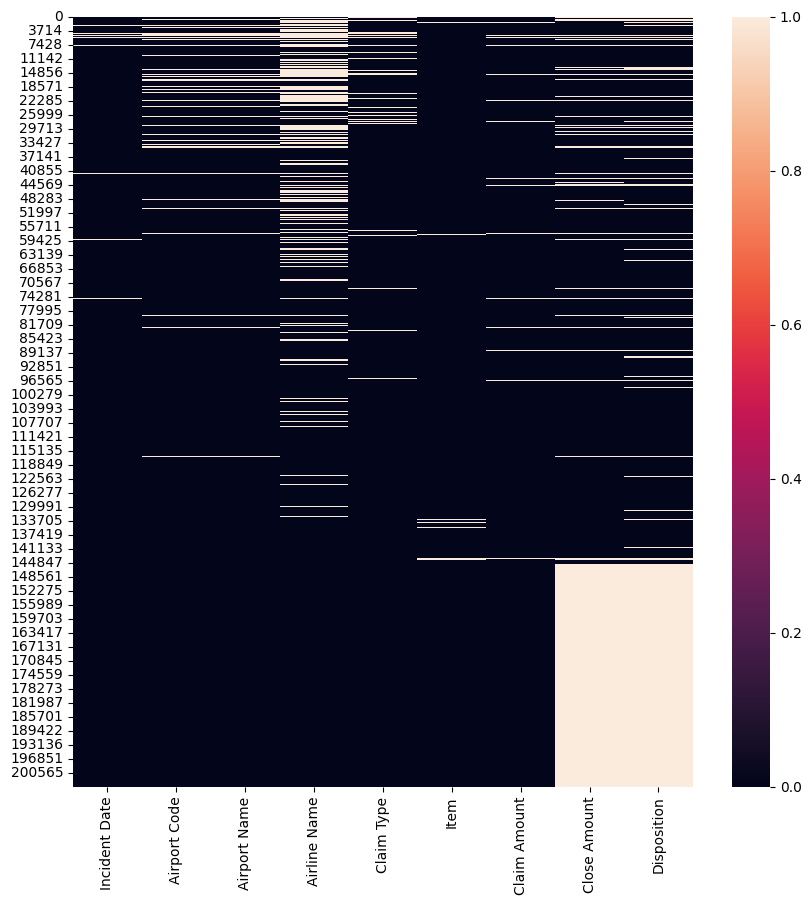

In [98]:
# Sebaran missing value di dalam data
plt.figure(figsize=(10,10))
sns.heatmap(df[['Incident Date','Airport Code', 'Airport Name', 'Airline Name', 'Claim Type', 'Item', 'Claim Amount', 'Close Amount', 'Disposition']].isna())

Dari plot di atas, terlihat bahwa sebaran missing value cukup acak kecuali pada 'Airport Code' dan 'Airport Name', serta 'Close Amount' dan 'Disposition' di sekitar seperempat akhir baris. Karena data ini cukup banyak relatif terhadap keseluruhan, kita tidak akan langsung menghapus data yang mengandung missing value ini.

In [99]:
# mempertahankan baris yang minimal terisi 6 value
df.dropna(thresh=6, inplace=True)

In [100]:
# menghapus kolom yang tidak digunakan dalam analisa
df.drop(['Claim Number','Date Received', 'Disposition'], axis=1, inplace=True)

In [101]:
df.shape

(203452, 10)

Setelah dilakukan penghapusan data berasarkan missing valuenya, terlihat masih tersisa 203.452 data. Selanjutnya kita akan menangani missing value pada tiap kolom yang ada.

### 'Incident Date'

Dari informasi sebelumnya, 'Incident Date' mengandung 1.07% missing value. Missing value ini akan dihapus karena relatif tidak banyak jumlahnya serta tidak dapat dilakukan pengisian.

In [102]:
df.dropna(subset='Incident Date', inplace=True)

In [103]:
df.shape

(202010, 10)

In [104]:
# mengubah - menjadi / serta membuat seluruh huruf menjadi huruf kecil
df['Incident Date'] = df['Incident Date'].str.replace('-', '/').str.lower()

In [105]:
# menghapus jam pada kolom Incident Date
incident_date = df['Incident Date'].str.split(pat = ' ', n=1, expand=True)
df['Incident Date'] = incident_date[0]

In [106]:
display(df.head(), df.tail())

,Incident Date,Airport Code,Airport Name,Airline Name,Claim Type,Claim Site,Item,Claim Amount,Status,Close Amount
0,12/12/2002,EWR,Newark International Airport,Continental Airlines,Property Damage,Checkpoint,Other,$350.00,Approved,$350.00
1,1/16/2004,SEA,Seattle-Tacoma International,NaN,Property Damage,Checked Baggage,Luggage (all types including footlockers),$100.00,Settled,$50.00
2,11/26/2003,STL,Lambert St. Louis International,American Airlines,Property Damage,Checked Baggage,Cell Phones,$278.88,Settled,$227.92
3,1/6/2003,MIA,Miami International Airport,American Airlines,Property Damage,Checkpoint,Luggage (all types including footlockers),$50.00,Approved,$50.00
4,2/5/2005,MCO,Orlando International Airport,Delta (Song),Property Damage,Checkpoint,Baby - Strollers; car seats; playpen; etc.,$84.79,Approved,$84.79


,Incident Date,Airport Code,Airport Name,Airline Name,Claim Type,Claim Site,Item,Claim Amount,Status,Close Amount
204262,16/oct/15,-,-,-,Property Damage,Checked Baggage,Baggage/Cases/Purses; Books; Magazines & Other; Clothing,-,-,NaN
204263,2/dec/15,-,-,-,Property Damage,Checked Baggage,Audio/Video; Home Decor,-,-,NaN
204264,20/dec/15,-,-,-,Passenger Property Loss,Checked Baggage,Clothing,-,-,NaN
204265,28/dec/15,-,-,-,Passenger Property Loss,Checked Baggage,Tools & Home Improvement Supplies,-,-,NaN
204266,23/nov/15,-,-,-,Passenger Property Loss,Checkpoint,Personal Accessories,-,-,NaN


Terlihat bahwa format tanggal pada 'Incident Date' ada yang m/d/Y dan d/M/y. 

In [107]:
# menhapus data dengan format d/M/Y sebagai contoh '03/sep/0300'
regex_del1 = '(\d+)/([a-z]{3})/[0-9]{4}'
filter1 = df['Incident Date'].str.contains(regex_del1)
df = df[~filter1]
df.shape

(201846, 10)

In [108]:
# menghapus data dengan format m/d/y sebagai contoh '6/30/10'
regex_del2 = '(\d+)/(\d+)/[0-9]{2}$'
filter2 = df['Incident Date'].str.contains(regex_del2)
df = df[~filter2]
df.shape

(201845, 10)

Selanjutnya akan dilakukan perubahan data 'Incident Date' yang memiliki format d/M/y menjadi m/d/Y menggunakan regex.

In [109]:
regex_pattern = re.compile(r"(\d+)/([a-z]{3})/(\d{2})$")

In [110]:
# membuat function untuk mengubah format tanggal
month_dict = {"jan":1,"feb":2,"mar":3,"apr":4,"may":5,"jun":6,"jul":7,"aug":8,"sep":9,"oct":10,"nov":11,"dec":12}

def format_dates(regex, date_string):
    m = regex.match(date_string)
    if(m):
        day, month, year = m.group(1,2,3)
        return "{}/{}/{}".format(month_dict[month],day,"20"+year)
    else:
        return date_string

In [111]:
# apply function format_dates
df['Incident Date'] = df['Incident Date'].apply(lambda x : format_dates(regex_pattern, x))

In [112]:
df['Incident Date']

0         12/12/2002
1         1/16/2004 
2         11/26/2003
3         1/6/2003  
4         2/5/2005  
            ...     
204262    10/16/2015
204263    12/2/2015 
204264    12/20/2015
204265    12/28/2015
204266    11/23/2015
Name: Incident Date, Length: 201845, dtype: object

Terlihat bahwa di bagian akhir dari 'Incident Date' sudah berubah format menjadi m/d/Y.

In [113]:
# mengubah datatype dari string ke datetime
df['Incident Date'] = pd.to_datetime(df['Incident Date'], format="%m/%d/%Y")

In [114]:
# membuat kolom 'Incident Year' untuk keperluan analisa
df['Incident Year'] = df['Incident Date'].dt.year
df['Incident Year'] = pd.to_datetime(df['Incident Year'], format='%Y')

#### 'Airport Code' dan 'Airport Name'

In [115]:
# menghapus spasi berlebih dan mengisi data kosong dengan -
df['Airport Code'] = df['Airport Code'].str.strip().fillna('-')
df['Airport Name'] = df['Airport Name'].str.strip().fillna('-')

Untuk data kosong pada Airport Code dan Airport Name dilakukan pengisian '-'. Jadi untuk missing value nya akan memiliki kategori sendiri berupa '-'. Hal ini juga supaya tidak terlalu banyak menghapus data.

In [116]:
display(df['Airport Code'].value_counts(), df['Airport Name'].value_counts())

LAX    9551
JFK    9200
-      7430
EWR    6839
ORD    6811
       ... 
LNS    1   
PPG    1   
RME    1   
SLN    1   
UNK    1   
Name: Airport Code, Length: 465, dtype: int64

Los Angeles International Airport       9551
John F. Kennedy International           9200
-                                       7430
Newark International Airport            6839
Chicago O'Hare International Airport    6811
                                        ... 
Kirksville Regional                     1   
Lake Havasu City Municipal              1   
Hickory Regional Airport                1   
Griffiss Intl; ROME; NY                 1   
Unalakleet Airport                      1   
Name: Airport Name, Length: 467, dtype: int64

Dari informasi sebelumnya, kita tahu bahwa sebaran missing value di kolom 'Airport Code' dan 'Airport Name' berada di posisi yang sama. Jumlah data pada 5 teratas sudah sama (termasuk Airport Code '-'). Artinya data Airport Code dan Airport name juga sudah sesuai, sehingga sudah bersih.

### 'Airline Name'

In [117]:
# menghapus spasi berlebih dan mengisi data kosong dengan -
df['Airline Name'] = df['Airline Name'].str.strip()
df['Airline Name'].fillna('-', inplace=True)

In [118]:
df['Airline Name'].value_counts()

-                       36694
Delta Air Lines         25519
American Airlines       23782
Southwest Airlines      20482
UAL                     19822
                        ...  
Maxair                  1    
Royal Wings Airlines    1    
Globe Span Airlines     1    
Greyhound Air           1    
Air Aruba               1    
Name: Airline Name, Length: 233, dtype: int64

Karena terdapat beberapa penulisan yang berbeda untuk satu Airline seperti yang kita lihat di analisa unique value sebelumnya, maka kita akan merapihkan nya sehingga tiap Airline hanya memiliki satu nama saja sebagai berikut.

In [119]:
df['Airline Name'].replace('American Eagle', 'American Airlines', inplace=True)
df['Airline Name'].replace('American West', 'America West', inplace=True)
df['Airline Name'].replace('Aeroflot Russian International', 'Aero Flot', inplace=True)
df['Airline Name'].replace('Continental Express Inc', 'Continental Airlines', inplace=True)
df['Airline Name'].replace('Frontier Aviation Inc', 'Frontier Airlines', inplace=True)
df['Airline Name'].replace('Northwest International Airways Ltd', 'Northwest Airlines', inplace=True)
df['Airline Name'].replace('Skywest Airlines Australia', 'Skywest Airlines Inc USA', inplace=True)

### 'Claim Type'

In [120]:
# menghapus spasi berlebih
df['Claim Type'] = df['Claim Type'].str.strip()

In [121]:
df['Claim Type'].value_counts()

Passenger Property Loss    117398
Property Damage            74981 
Personal Injury            1453  
Employee Loss (MPCECA)     485   
Passenger Theft            465   
Motor Vehicle              367   
-                          282   
Complaint                  48    
Wrongful Death             4     
Compliment                 3     
Bus Terminal               1     
Name: Claim Type, dtype: int64

In [122]:
# mengubah '-' menjadi np.nan untuk dilakukan pengisian
df['Claim Type'].replace('-', np.nan, inplace=True)

Selanjutnya akan dilakukan pengisian missing value pada Claim Type berdasarkan modusnya pada tiap Airline. Jadi disini saya berasumsi bahwa tiap Airline akan memiliki kecenderungan Claim Type yang sesuai dengan modus Claim Type yang diterima.

In [123]:
# melihat modus Claim Type pada tiap Airline
df.groupby(['Airline Name']).describe(include='object')['Claim Type']['top']

Airline Name
-                       Property Damage        
ATA Aerocondor          Passenger Property Loss
Aer Lingus              Passenger Property Loss
Aero California         Property Damage        
Aero Costa Rica         Passenger Property Loss
                                 ...           
Westjet Airlines Ltd    Passenger Property Loss
Wiggins Airways         Passenger Property Loss
XL Airways              Passenger Property Loss
Xtra Airways            Passenger Property Loss
vivaAerobus             Motor Vehicle          
Name: top, Length: 226, dtype: object

In [124]:
# index missing value di kolom 'Claim Type'
index_nan = df.loc[df['Claim Type'].isna()].index

In [125]:
# mengisi missing value di kolom 'Claim Type' dengan modus berdasarkan 'Airline Name'
df['Claim Type'] = df.groupby('Airline Name')['Claim Type'].apply(lambda x: x.fillna(x.describe(include='object')['top']))

In [126]:
# mengisi missing value yang tersisa dengan 'Passenger Property Loss' sebagai modus Claim Type keseluruhan
df['Claim Type'].fillna('Passenger Property Loss', inplace=True)

In [127]:
# melihat jumlah data Claim Type yang telah diisikan
df.loc[index_nan]['Claim Type'].value_counts()

Passenger Property Loss    4063
Property Damage            2577
Name: Claim Type, dtype: int64

In [128]:
df.shape

(201845, 11)

Sampai di tahap ini kita masih memiliki 201.845 tersisa dari 204.267 data di awal.

### 'Status'

In [129]:
df['Status'] = df['Status'].str.strip()
df['Status'].value_counts()

Denied                                                                                                                           67923
Approved                                                                                                                         34733
Deny                                                                                                                             28234
Settled                                                                                                                          27727
-                                                                                                                                12749
Approve in Full                                                                                                                  12363
Canceled                                                                                                                         6398 
Settle                                                 

Di kolom 'Status' ini terlihat bahwa ada beberapa unique value yang memiliki arti yang sama. Berikutnya kita akan golongkan menjadi 3 saja yaitu Approved, Settled, dan Denied. Untuk sisanya akan dilakukan penghapusan data karena kita anggap klaim yang diajukan belum valid untuk dianalisa.

In [130]:
df['Status'].replace('Deny', 'Denied', inplace=True)
df['Status'].replace('Approve in Full', 'Approved', inplace=True)
df['Status'].replace('Settle', 'Settled', inplace=True)
df['Status'].value_counts()

Denied                                                                                                                           96157
Approved                                                                                                                         47096
Settled                                                                                                                          33491
-                                                                                                                                12749
Canceled                                                                                                                         6398 
Insufficient; one of the following items required: sum certain; statement of fact; signature; location of incident; and date.    4536 
Closed as a contractor claim                                                                                                     1300 
In litigation                                          

In [131]:
# menghapus baris dengan status yang tidak valid
valid_status = ['Denied', 'Approved', 'Settled']
df = df[df['Status'].isin(valid_status)]
df['Status'].value_counts()

Denied      96157
Approved    47096
Settled     33491
Name: Status, dtype: int64

### 'Claim Site'

In [132]:
# menghapus spasi berlebih
df['Claim Site'] = df['Claim Site'].str.strip()

In [133]:
df['Claim Site'].value_counts()

Checked Baggage    140719
Checkpoint         34340 
Other              1049  
Motor Vehicle      305   
-                  66    
Bus Station        10    
Name: Claim Site, dtype: int64

In [134]:
# mengubah '-' menjadi np.nan
df['Claim Site'].replace('-', np.nan, inplace=True)

Selanjutnya 'Claim Site' memiliki missing value yang jumlahnya relatif kecil sehingga untuk data dengan missing value pada 'Claim Site' akan dihapus.

In [135]:
df.dropna(subset='Claim Site', inplace=True)

### 'Item'

In [136]:
df['Item'].str.strip().value_counts()

Other                                                                                                                           32199
Luggage (all types including footlockers)                                                                                       17258
Clothing - Shoes; belts; accessories; etc.                                                                                      13362
Locks                                                                                                                           8918 
Jewelry - Fine                                                                                                                  8547 
                                                                                                                                ...  
Eyeglasses - (including contact lenses); Jewelry - Costume; Other                                                               1    
Boxes - Jewelry; Cigarette; Music; etc.; Clothing - Shoes; bel

Terlihat bahwa kolom 'Item' memiliki variasi yang banyak sekali. Kita bisa lihat juga bahwa kolom 'Item' memiliki 4.704 unique value. Dalam analisa ini kita juga tidak melakukan analisa terhadap kolom 'Item'. Berikutnya missing value pada kolom 'Item' akan diisi dengan '-' .

In [137]:
df['Item'].fillna('-', inplace=True)

### 'Claim Amount' & 'Close Amount'

In [138]:
display(df['Claim Amount'].value_counts(), df['Close Amount'].value_counts())

$0.00         28227
$100.00       3532 
$50.00        3224 
$200.00       2932 
$150.00       2808 
              ...  
$354.37       1    
$685.32       1    
$3;273.00     1    
$107.27       1    
$3;668.84     1    
Name: Claim Amount, Length: 34848, dtype: int64

$0.00       65613
$50.00      4600 
$100.00     1519 
$25.00      1273 
$20.00      1162 
            ...  
$57.37      1    
$126.79     1    
$241.48     1    
$137.95     1    
$826.72     1    
Name: Close Amount, Length: 17065, dtype: int64

Dari informasi di atas, terlihat bahwa 'Claim Amount' dan 'Close Amount' masih memiliki lambang '$', typo seperti ';', serta nilai berupa '-' yang perlu ditangani. Selain itu, nilai Claim Amount yang bernilai 0 akan diubah juga menjadi np.nan dan akan ditangani kemudian.

In [139]:
df['Claim Amount'] = df['Claim Amount'].str.strip().str.replace('$','').str.replace(';','').str.replace('-', '0')
df['Claim Amount'].replace('0.00', np.nan, inplace=True)
df['Claim Amount'] = df['Claim Amount'].astype(float)

In [140]:
df['Close Amount'] = df['Close Amount'].str.strip().str.replace('$','').str.replace(';','').str.replace('-', '0')
df['Close Amount'] = df['Close Amount'].astype(float)

In [141]:
# mengecek kembali missing value yang tersisa
df.isnull().sum()

Incident Date    0    
Airport Code     0    
Airport Name     0    
Airline Name     0    
Claim Type       0    
Claim Site       0    
Item             0    
Claim Amount     28503
Status           0    
Close Amount     47679
Incident Year    0    
dtype: int64

<AxesSubplot: xlabel='Claim Amount'>

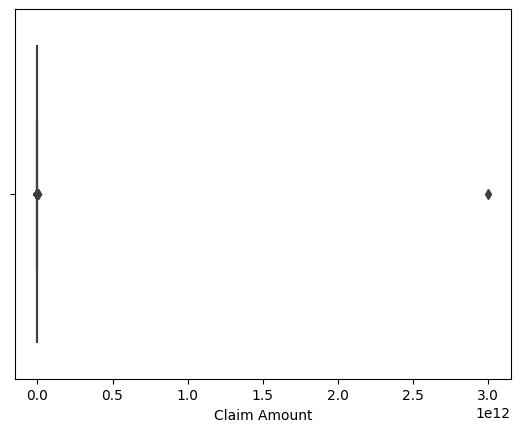

In [142]:
# melihat distribusi data pada Claim Amount
sns.boxplot(x=df['Claim Amount'])

Terlihat adanya outlier yang nilai nya sangat tinggi dibanding yang lain. Untuk Data ini akan kita hapus dengan batasan maksimal klaim sebesar 1,000,000,000.

In [143]:
# menghapus data outlier pada Claim Amount
df = df[(df['Claim Amount'] < 1000000000) | (df['Claim Amount'].isnull())]

<AxesSubplot: xlabel='Claim Amount'>

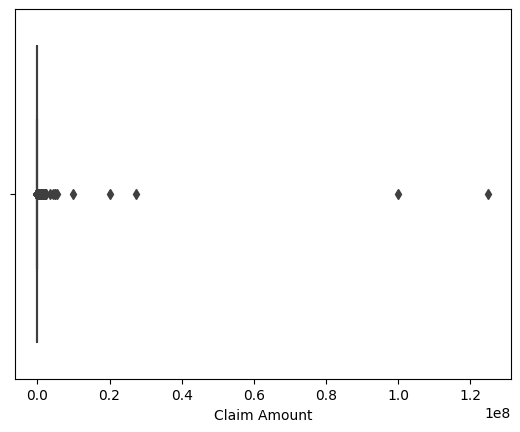

In [144]:
# mengecek kembali distribusi pada Claim Amount
sns.boxplot(x=df['Claim Amount'])

Terlihat bahwa distribusi data tidak normal (right skewed) dan ada beberapa outlier yang bernilai sangat besar.

<AxesSubplot: xlabel='Close Amount'>

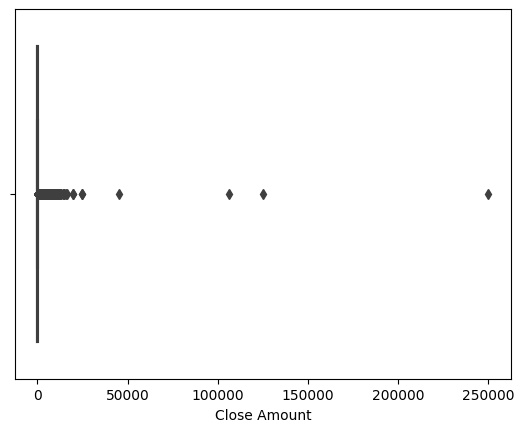

In [145]:
# melihat distribusi data pada Close Amount
sns.boxplot(x=df['Close Amount'])

Terlihat bahwa distribusi data pada Close Amount juga tidak normal (right skewed) dan ada beberapa outlier yang bernilai sangat besar.

In [146]:
df.shape

(176420, 11)

In [147]:
# menghitung persentase close amount terhadap claim amount untuk status yang ber status 'Settled'
df_settled = df[df['Status'] == 'Settled']
settled_percentage = df_settled['Close Amount'].median() / df_settled['Claim Amount'].median()
print('settled_percentage:', settled_percentage)

settled_percentage: 0.4817419789960497


Selanjutnya akan dilakukan pengisian pada missing value di Claim Amount dan Close Amount dengan cara berikut. <br>

Untuk Claim Amount : <br>
Claim Amount NA, Status 'Approved', Close Amount > 0 --> diisi dengan nilai Close Amount <br>
Claim Amount NA, Status 'Settled', Close Amount > 0 --> diisi dengan nilai Close Amount / settled_percentage <br>
Claim Amount NA, Status 'Denied', Close Amount = 0 --> diisi dengan nilai median dari Claim Amount <br>

Untuk Close Amount : <br>
Close Amount NA, Status 'Approved', Claim Amount > 0 --> diisi dengan nilai Claim Amount <br>
Close Amount NA, Status 'Settled', Claim Amount > 0 --> diisi dengan nilai Claim Amount*settled_percentage <br>
Close Amount NA, Status 'Denied', Claim Amount > 0 --> diisi dengan nilai 0

In [148]:
df['Claim_Amount_Cleaned'] = np.where(((df['Claim Amount'].isnull()) & (df['Status'] == 'Approved') & (df['Close Amount'] > 0)), df['Close Amount'], df['Claim Amount'])
df['Claim_Amount_Cleaned'] = np.where((df['Claim Amount'].isnull()) & (df['Status'] == 'Settled') & (df['Close Amount'] > 0), df['Close Amount']/settled_percentage, df['Claim_Amount_Cleaned'])
df['Claim_Amount_Cleaned'] = np.where((df['Claim Amount'].isnull()) & (df['Status'] == 'Denied') & (df['Close Amount'] == 0), df['Claim Amount'].median() , df['Claim_Amount_Cleaned'])

In [149]:
df['Close_Amount_Cleaned'] = np.where((df['Close Amount'].isnull()) & (df['Status'] == 'Approved') & (df['Claim Amount'] > 0), df['Claim Amount'], df['Close Amount'])
df['Close_Amount_Cleaned'] = np.where((df['Close Amount'].isnull()) & (df['Status'] == 'Settled') & (df['Claim Amount'] > 0), df['Claim Amount']*settled_percentage, df['Close_Amount_Cleaned'])
df['Close_Amount_Cleaned'] = np.where((df['Close Amount'].isnull()) & (df['Status'] == 'Denied') & (df['Claim Amount'] > 0), 0, df['Close_Amount_Cleaned'])

In [150]:
# mengecek kembali missing value
df.isnull().sum()

Incident Date           0    
Airport Code            0    
Airport Name            0    
Airline Name            0    
Claim Type              0    
Claim Site              0    
Item                    0    
Claim Amount            28503
Status                  0    
Close Amount            47679
Incident Year           0    
Claim_Amount_Cleaned    28194
Close_Amount_Cleaned    28191
dtype: int64

Berikutnya untuk missing value yang tersisa akan diisikan sebagai berikut. Pengisian missing value banyak menggunakan median mengingat bahwa distribusi pada Claim Amount dan Close Amount merupakan distribusi yang tidak normal.

Untuk Close Amount : <br>
Close Amount NA, Status 'Approved' --> diisi dengan nilai median Close Amount <br>
Close Amount NA, Status 'Settled' --> diisi dengan nilai median Close Amount <br>
Close Amount NA, Status 'Denied' --> diisi dengan nilai 0

Untuk Claim Amount : <br>
Claim Amount NA, Status 'Approved' --> diisi dengan nilai Close Amount <br>
Claim Amount NA, Status 'Settled' --> diisi dengan nilai Close Amount / settled_percentage <br>
Claim Amount NA, Status 'Denied' --> diisi dengan nilai median dari Claim Amount <br>

In [151]:
# menghitung nilai median
close_med = df['Close_Amount_Cleaned'].median()
claim_med = df['Claim_Amount_Cleaned'].median()

In [152]:
df['Close_Amount_Cleaned'] = np.where((df['Close Amount'].isnull()) & (df['Status'] == 'Approved'), close_med, df['Close_Amount_Cleaned'])
df['Close_Amount_Cleaned'] = np.where((df['Close Amount'].isnull()) & (df['Status'] == 'Settled'), close_med, df['Close_Amount_Cleaned'])
df['Close_Amount_Cleaned'] = np.where((df['Close Amount'].isnull()) & (df['Status'] == 'Denied'), 0, df['Close_Amount_Cleaned'])

In [153]:
df['Claim_Amount_Cleaned'] = np.where((df['Claim Amount'].isnull()) & (df['Status'] == 'Approved'), df['Close_Amount_Cleaned'], df['Claim_Amount_Cleaned'])
df['Claim_Amount_Cleaned'] = np.where((df['Claim Amount'].isnull()) & (df['Status'] == 'Settled'), df['Close_Amount_Cleaned']/settled_percentage, df['Claim_Amount_Cleaned'])
df['Claim_Amount_Cleaned'] = np.where((df['Claim Amount'].isnull()) & (df['Status'] == 'Denied'), claim_med, df['Claim_Amount_Cleaned'])

In [154]:
# menghapus kolom 'Claim Amount' dan 'Close Amount' yang lama
df.drop(['Claim Amount','Close Amount'], axis=1, inplace=True)
df = df.rename(columns={"Claim_Amount_Cleaned" : "Claim_Amount"})
df = df.rename(columns={"Close_Amount_Cleaned" : "Close_Amount"})

In [155]:
df.isnull().sum()

Incident Date    0
Airport Code     0
Airport Name     0
Airline Name     0
Claim Type       0
Claim Site       0
Item             0
Status           0
Incident Year    0
Claim_Amount     0
Close_Amount     0
dtype: int64

In [156]:
df.shape

(176420, 11)

Dataset sudah siap untuk dianalisa.

# Data Analisis

### Total Klaim Berdasarkan Status Klaim

<AxesSubplot: title={'center': 'Total Claim by Status'}, xlabel='Status', ylabel='count'>

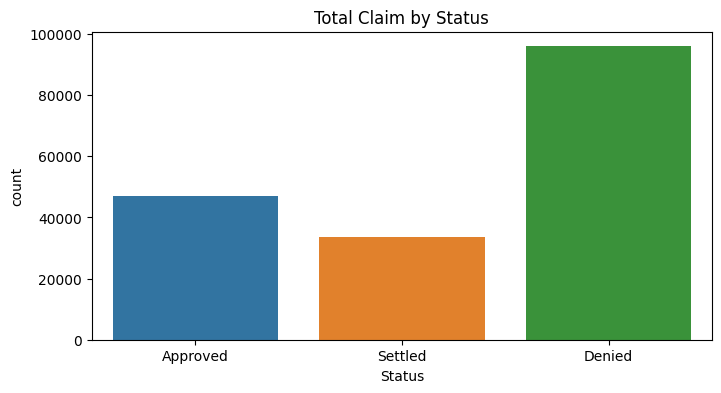

In [157]:
plt.figure(figsize=(8,4),dpi=100)
plt.title('Total Claim by Status')
sns.countplot(x=df['Status'])

In [158]:
df['Status'].value_counts()/len(df)

Denied      0.543759
Approved    0.266580
Settled     0.189661
Name: Status, dtype: float64

Berdasarkan plot di atas, Claim yang diterima TSA ternyata 54% ditolak (Denied), 19% disetujui dengan nilai penuh (Approved), serta sisanya 27% disetujui tetapi nilainya tidak penuh (Settled). Melihat jumlah di atas, berarti bahwa klaim yang diajukan tidak semerta-merta akan disetujui oleh TSA namun melalui proses penilaian yang cukup selektif.

### Trend Jumlah Klaim Tahunan

In [159]:
claim_year = df.groupby('Incident Year', as_index=False)['Incident Year'].value_counts()
claim_year

,Incident Year,count
0,1996-01-01,1
1,2000-01-01,10
2,2001-01-01,10
3,2002-01-01,1661
4,2003-01-01,21886
5,2004-01-01,26099
6,2005-01-01,21151
7,2006-01-01,17416
8,2007-01-01,17062
9,2008-01-01,14770


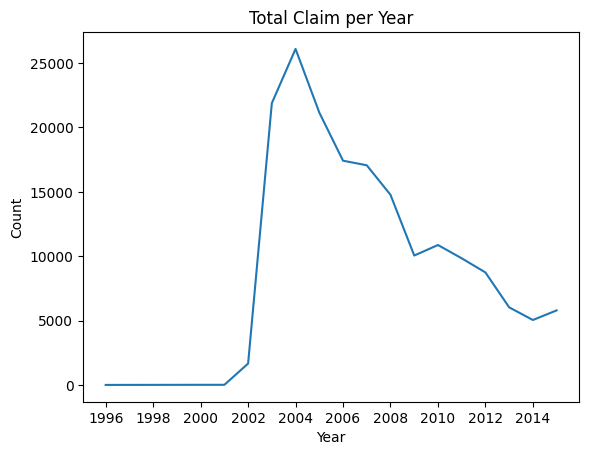

In [160]:
plt.title('Total Claim per Year')
sns.lineplot(data = claim_year, x='Incident Year', y='count')
plt.xlabel('Year')
plt.ylabel('Count')
plt.show()

Dari plot di atas, terlihat bahwa jumlah klaim mengalami kenaikan signifikan di tahun 2003 dan mencapai jumlah tertinggi di tahun 2004. Kemudian jumlah klaim mengalami penurunan mulai tahun 2005. Dikutip dari website resmi TSA https://www.tsa.gov/history, terdapat informasi bahwa TSA didirikan di tahun 2001. Hal inilah yang menyebabkan di tahun-tahun awal berdirinya TSA, orang-orang mulai mengajukan klaimnya ke TSA. Seiring berjalannya waktu, TSA semakin mengembangkan dan meningkatkan standar keamanan yang ada, sehingga jumlah klaim pun menurun di tahun-tahun berikutnya.

### Tipe Klaim Terbanyak

<AxesSubplot: title={'center': 'Claim Type Frequency'}, xlabel='count', ylabel='Claim Type'>

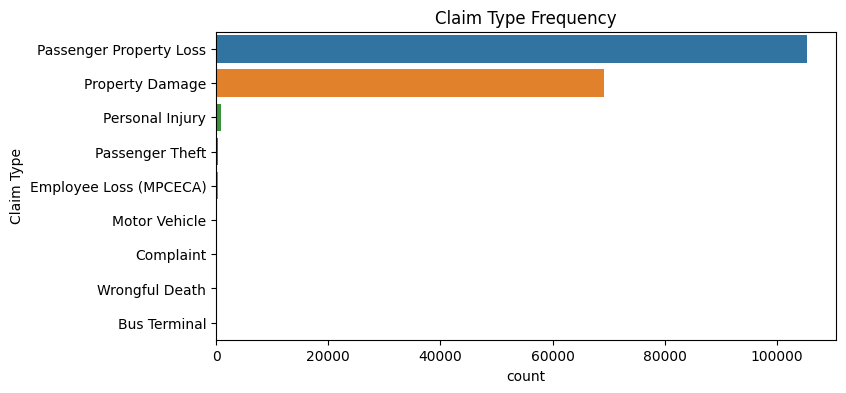

In [161]:
plt.figure(figsize=(8,4),dpi=100)
plt.title('Claim Type Frequency')
sns.countplot(data=df, y=df['Claim Type'], order = df['Claim Type'].value_counts().index)

Tipe klaim terbanyak didominasi oleh Passenger Property Loss dan Property Damage. TSA selanjutnya dapat memfokuskan kepada standar penanganan dari barang-barang/properti yang dibawa oleh penumpang untuk mengurangi terjadinya kehilangan maupun kerusakan. Dengan demikian, jumlah klaim pun dapat berkurang.

### Lokasi Klaim Terbanyak

<AxesSubplot: title={'center': 'Claim Site Frequency'}, xlabel='count', ylabel='Claim Site'>

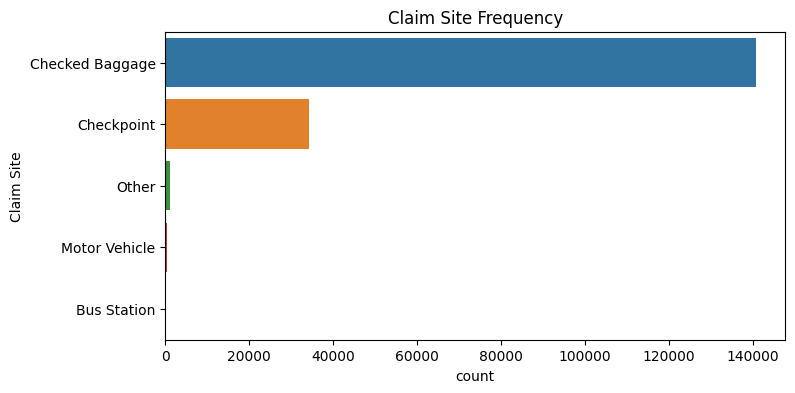

In [162]:
plt.figure(figsize=(8,4),dpi=100)
plt.title('Claim Site Frequency')
sns.countplot(data=df, y=df['Claim Site'], order = df['Claim Site'].value_counts().index)

Lokasi klaim didominasi oleh Checked Baggage dan Checkpoint. Hal ini sejalan dengan analisa sebelumnya dimana tipe klaim yang diajukan didominasi oleh property loss dan property damage yang berarti adanya kurang baiknya penanganan yang dilakukan oleh petugas. Di lokasi Checkpoint ada kemungkinan dimana properti diperlakukan kurang baik sehingga menyebabkan kerusakan. Sedangkan pada Checked Baggage ini properti penumpang akan dibawa menuju kargo pesawat. Penanganan pada saat transportasi dari lokasi Check In menuju  kargo inilah yang biasanya menyebabkan kerusakan ataupun kehilangan.

### Top 10 Airport dengan Klaim Terbanyak

<AxesSubplot: title={'center': 'Top 10 Airport With Highest Claims'}, xlabel='count', ylabel='Airport Name'>

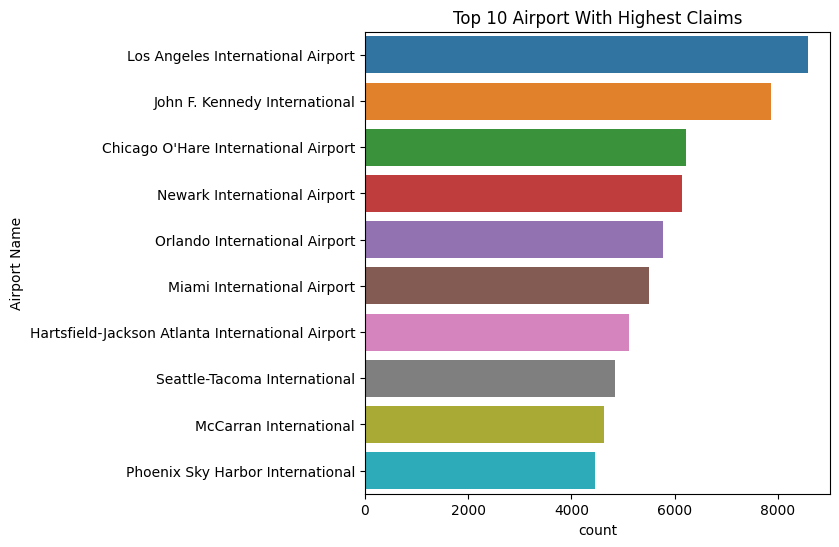

In [163]:
plt.figure(figsize=(6,6),dpi=100)
plt.title('Top 10 Airport With Highest Claims')
sns.countplot(data=df, y=df['Airport Name'], order = df['Airport Name'].value_counts().iloc[:10].index)

Dari plot di atas, kita dapat mengetahui 10 besar Airport dengan jumlah klaim terbanyak. Dilansir dari https://www.usatoday.com/story/travel/news/2022/10/15/what-is-the-busiest-airport/10341892002/ , 5 dari 10 Airport di atas termasuk dalam 10 besar Airport dengan penerbangan terbanyak di USA. Hal ini kemudian wajar jika nama airport-airport di atas mendominasi dalam pengajuan klaim ke TSA. Selanjutnya, akan dilakukan analisa lebih lanjut mengenai Top 10 Airport tersebut.

In [164]:
top_10_airport = df['Airport Name'].value_counts().iloc[:10].index

In [165]:

tab = pd.crosstab(df['Airport Name'],df['Claim Site'], normalize='index')
viz = tab.loc[top_10_airport]

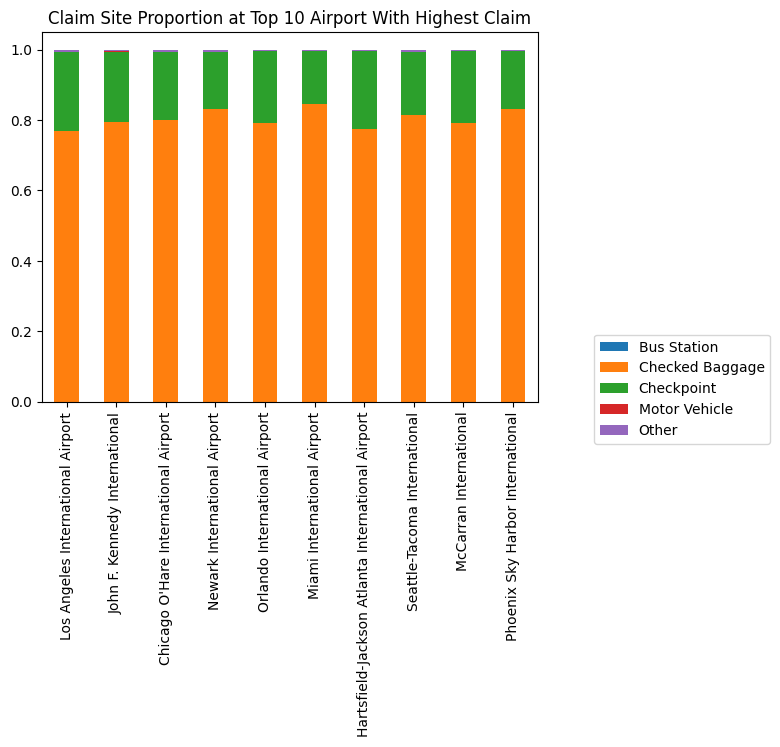

In [166]:
viz.plot(kind='bar', stacked=True)
plt.title('Claim Site Proportion at Top 10 Airport With Highest Claim')
plt.legend(bbox_to_anchor=(1.1, 0.2))

Dari plot di atas, terlihat bahwa sekitar 80% lokasi klaim yang diajukan di Top 10 Airport ini berada di Checked Baggage yang berarti bahwa telah terjadinya penangangan yang kurang baik pada properti yang di Check In oleh penumpang. Sedangkan sekitar 20% lokasi klaim nya berada di Checkpoint yang berarti juga telah terjadinya penangangan properti yang kurang baik saat melalui proses screening di Checkpoint.

In [167]:
tab2 = pd.crosstab(df['Airport Name'],df['Claim Type'], normalize='index')
viz2 = tab2.loc[top_10_airport]

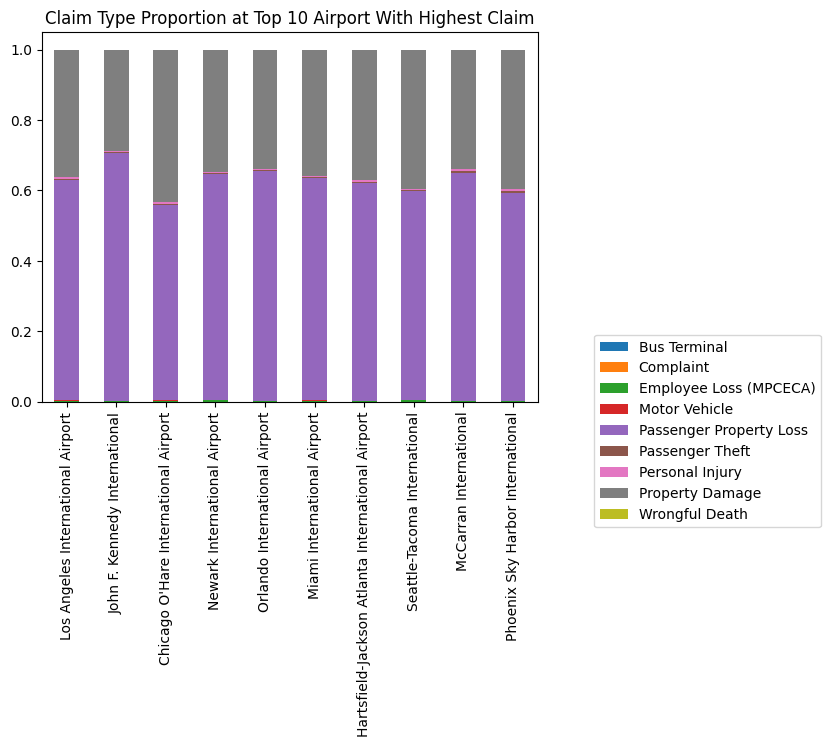

In [168]:
viz2.plot(kind='bar', stacked=True)
plt.title('Claim Type Proportion at Top 10 Airport With Highest Claim')
plt.legend(bbox_to_anchor=(1.1, 0.2))

Selain lokasi klaim, kita dapat melihat juga tipe klaim yang diajukan di Top 10 Airport. Dari plot di atas, terlihat bahwa secara umum tipe klaim didominasi oleh Passenger Property Loss dengan proporsi sekitar 60% dan Property Damage sekitar 40%. Pada Airport John F. Kennedy International, sekitar 70% dari tipe klaim nya yaitu Passanger Property Loss. Hal ini mungkin bisa disebabkan karena adanya kelalaian dari petugas saat mentransportasikan properti menuju kargo. Kemudian pada Airport Chicago O'Hare International, sekitar 45% nya justru didominasi oleh Property Damage. Hal ini mungkin disebabkan karena adanya SOP yang kurang baik dalam penanganan properti penumpang, baik yang disebabkan oleh mesin ataupun manusia.

### Top 10 Airline dengan Klaim Terbanyak

In [169]:
# menfilter Airline dengan nama '-'
df_airline = df[df['Airline Name'] != '-']

<AxesSubplot: title={'center': 'Top 10 Airline With Highest Claims'}, xlabel='count', ylabel='Airline Name'>

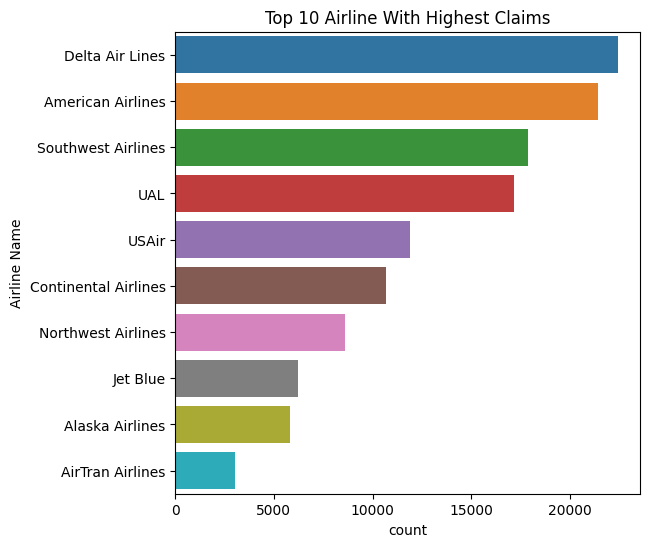

In [170]:
plt.figure(figsize=(6,6),dpi=100)
plt.title('Top 10 Airline With Highest Claims')
sns.countplot(data=df_airline, y=df_airline['Airline Name'], order = df_airline['Airline Name'].value_counts().iloc[:10].index)

Berdasarkan informasi dari https://flyustravels.com/blog/list-of-top-ranked-and-largest-airlines-in-the-us/ , 6 dari Airline di atas termasuk dalam 10 besar Airline dengan jumlah penumpang terbanyak. Hal ini cukup mendukung dengan semakin banyak penumpang yang diangkut maka semakin besar probabilitas pengajuan klaim oleh penumpang. Namun perlu menjadi catatan bahwa ada 16% data Airline yang tidak tersedia.

### Claim Amount dan Close Amount

Untuk melihat distribusi Claim Amount dan Close Amount akan digunakan Claim Amount yang bernilai kurang dari percentile ke-95. Hal ini untuk mengeluarkan outlier yang terlalu tinggi nilainya.

In [171]:
# Menggunakan 95% data untuk analisa Amount
df_amount = df[df['Claim_Amount'] < np.percentile(df['Claim_Amount'], 95)]

In [172]:
fig = px.box(df_amount, x="Status", y='Claim_Amount')
fig.update_layout(title="Claim Amount Distribution by Status")
fig.show()

Dari plot di atas terlihat bahwa klaim yang disetujui (Approved) memiliki nilai median yang relatif lebih rendah ($62.86) dibanding Claim dengan Status Settled ($200) dan Denied ($157.65). Tentunya untuk jumlah klaim yang lebih kecil akan lebih mudah disetujui oleh TSA, sebaliknya untuk pengajuan klaim dengan jumlah yang lebih besar akan sulit disetujui oleh TSA.

In [173]:
fig = px.box(df_amount, x="Claim Type", y='Claim_Amount')
fig.update_layout(title="Claim Amount Distribution by Claim Type")
fig.show()

Dari plot di atas, terlihat bahwa untuk masing-masing tipe claim memiliki distribusi Claim Amount yang cukup berbeda. Untuk Property Damage dan Passenger Property Loss memiliki median yang mirip di sekitar $157. Hal ini bisa menjadi petunjuk untuk TSA bahwa median nilai klaim yang sering diajukan oleh penumpang akan berkisar di angka $157. Selain itu, Motor Vehicle terlihat memiliki nilai median yang paling tinggi ($677). TSA perlu memberi perhatian lebih untuk penanganan Kendaraan (Motor Vehicle) supaya dapat menghindari jumlah klaim yang besar.

In [174]:
fig = px.box(df_amount, x="Claim Type", y='Close_Amount')
fig.update_layout(title="Close Amount Distribution by Claim Type")
fig.show()

Dari plot distribusi Close Amount di atas, terlihat bahwa nilai mediannya relatif lebih kecil dibanding Claim Amount. Di plot sebelumnya juga sudah diperoleh informasi bahwa 54% klaim ditolak, sehingga tentunya nilai Close Amount akan memiliki nilai median yang lebih kecil.

# Kesimpulan dan Rekomendasi

Berdasarkan analisa yang telah dilakukan dapat diperoleh kesimpulan sebagai berikut :
- TSA cukup selektif dalam memberikan persetujuan klaim (sebanyak 54% klaim ditolak/Denied).
- Jumlah klaim mengalami kenaikan signifikan di tahun 2003 (awal berdirinya TSA) dan mengalami penurunan mulai tahun 2005 seiring berjalannya waktu dan berkembangnya TSA.
- Passenger Property Loss dan Property Damage merupakan 2 tipe klaim yang paling sering diajukan.
- Checked Baggage dan Checkpoint merupakan 2 lokasi klaim yang paling sering diajukan.
- Semakin banyak penerbangan di suatu Airport akan meningkatkan resiko pengajuan klaim.
- Semakin banyak penerbangan di suatu Airline akan meningkatkan resiko pengajuan klaim.
- TSA cenderung lebih mudah menyetujui klaim dengan jumlah yang lebih kecil.
- Nilai klaim yang sering diajukan berkisar di angka $157 berdasarkan tipe klaim yang paling sering diajukan.

Selanjutnya saya memberikan beberapa rekomendasi kepada TSA sebagai berikut :
- TSA dapat mempertahankan selektifitas dalam persetujuan klaim.
- TSA dapat fokus memperbaiki dan meningkatkan standar penanganan (SOP) Properti di lokasi Checked Baggage dan Checkpoint supaya dapat mengurangi frekuensi terjadinya kehilangan dan kerusakan barang/properti.
- TSA dapat fokus ke 10 besar Airport dengan jumlah pengajuan klaim terbanyak agar jumlah klaim dapat berkurang signifikan, misalnya dengan menambah jumlah petugas di Airport tersebut.
- TSA dapat meningkatkan aturan standar pengamanan dan bekerjasama dengan Airline yang memiliki jumlah penumpang terbanyak.
- TSA dapat lebih selektif untuk pengajuan klaim dengan pengajuan di atas $157, sebagai contoh membuat persyaratan yang lebih ketat untuk klaim di atas nilai $157.